In [1]:
#Read in our data
import pandas as pd
clean_df = pd.read_csv('Resources/Training_Data (1).csv')


In [2]:
#Bring in dependencies
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn import preprocessing

from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import roc_auc_score # AUC ROC
from sklearn.metrics import average_precision_score # AUC PRC
from sklearn.metrics import confusion_matrix

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report

from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
     

In [3]:
# Ensuring DF created correctly
clean_df.head()

,Id,Income,Age,Experience,Married/Single,House_Ownership,Car_Ownership,Profession,CITY,STATE,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Risk_Flag
0,1,1303834,23,3,single,rented,no,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13,0
1,2,7574516,40,10,single,rented,no,Software_Developer,Parbhani,Maharashtra,9,13,0
2,3,3991815,66,4,married,rented,no,Technical_writer,Alappuzha,Kerala,4,10,0
3,4,6256451,41,2,single,rented,yes,Software_Developer,Bhubaneswar,Odisha,2,12,1
4,5,5768871,47,11,single,rented,no,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14,1


In [4]:
#dropped the unnecessary data from out dataframe
clean_df = clean_df.drop(columns=['Id'])


In [5]:
# Confirming the ID Column dropped
clean_df.head()

,Income,Age,Experience,Married/Single,House_Ownership,Car_Ownership,Profession,CITY,STATE,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Risk_Flag
0,1303834,23,3,single,rented,no,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13,0
1,7574516,40,10,single,rented,no,Software_Developer,Parbhani,Maharashtra,9,13,0
2,3991815,66,4,married,rented,no,Technical_writer,Alappuzha,Kerala,4,10,0
3,6256451,41,2,single,rented,yes,Software_Developer,Bhubaneswar,Odisha,2,12,1
4,5768871,47,11,single,rented,no,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14,1


In [6]:
# Define features set
X = clean_df.copy()
X.drop("Risk_Flag", axis=1, inplace=True)
X.head()

,Income,Age,Experience,Married/Single,House_Ownership,Car_Ownership,Profession,CITY,STATE,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS
0,1303834,23,3,single,rented,no,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13
1,7574516,40,10,single,rented,no,Software_Developer,Parbhani,Maharashtra,9,13
2,3991815,66,4,married,rented,no,Technical_writer,Alappuzha,Kerala,4,10
3,6256451,41,2,single,rented,yes,Software_Developer,Bhubaneswar,Odisha,2,12
4,5768871,47,11,single,rented,no,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14


In [7]:
# Define target vector
y = clean_df["Risk_Flag"].values.reshape(-1, 1)
y[:5]

array([[0],
       [0],
       [0],
       [1],
       [1]])

In [8]:
# Preview the features data
X.head()

,Income,Age,Experience,Married/Single,House_Ownership,Car_Ownership,Profession,CITY,STATE,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS
0,1303834,23,3,single,rented,no,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13
1,7574516,40,10,single,rented,no,Software_Developer,Parbhani,Maharashtra,9,13
2,3991815,66,4,married,rented,no,Technical_writer,Alappuzha,Kerala,4,10
3,6256451,41,2,single,rented,yes,Software_Developer,Bhubaneswar,Odisha,2,12
4,5768871,47,11,single,rented,no,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14


In [9]:
# Preview the first five entries for the target variable
y[:5]

array([[0],
       [0],
       [0],
       [1],
       [1]])

In [10]:
# Encode the categorical variables using get_dummies
X = pd.get_dummies(X)

In [11]:
# Ensure the data was encoded
X.head()

,Income,Age,Experience,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Married/Single_married,Married/Single_single,House_Ownership_norent_noown,House_Ownership_owned,House_Ownership_rented,...,STATE_Punjab,STATE_Rajasthan,STATE_Sikkim,STATE_Tamil_Nadu,STATE_Telangana,STATE_Tripura,STATE_Uttar_Pradesh,STATE_Uttar_Pradesh[5],STATE_Uttarakhand,STATE_West_Bengal
0,1303834,23,3,3,13,False,True,False,False,True,...,False,False,False,False,False,False,False,False,False,False
1,7574516,40,10,9,13,False,True,False,False,True,...,False,False,False,False,False,False,False,False,False,False
2,3991815,66,4,4,10,True,False,False,False,True,...,False,False,False,False,False,False,False,False,False,False
3,6256451,41,2,2,12,False,True,False,False,True,...,False,False,False,False,False,False,False,False,False,False
4,5768871,47,11,3,14,False,True,False,False,True,...,False,False,False,True,False,False,False,False,False,False


In [12]:
# Splitting into Train and Test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=78)

In [13]:
# Creating StandardScaler instance
scaler = StandardScaler()

In [14]:
# Fitting Standard Scaller
X_scaler = scaler.fit(X_train)

In [15]:
# Scaling data
X_train_scaled = X_scaler.transform(X_train)
X_test_scaled = X_scaler.transform(X_test)

In [16]:
# Creating the decision tree classifier instance
model = tree.DecisionTreeClassifier()

In [17]:
# Fitting the model
model = model.fit(X_train_scaled, y_train)

In [18]:
# Making predictions using the testing data
predictions = model.predict(X_test_scaled)

In [19]:
## Model Evaluation
# Calculating the confusion matrix
cm = confusion_matrix(y_test, predictions)
cm_df = pd.DataFrame(
    cm, index=["Actual 0", "Actual 1"], columns=["Predicted 0", "Predicted 1"]
)
# Calculating the accuracy score
acc_score = accuracy_score(y_test, predictions)

In [20]:
# Displaying results
print("Confusion Matrix")
display(cm_df)
print(f"Accuracy Score : {acc_score}")
print("Classification Report")
print(classification_report(y_test, predictions))

Confusion Matrix


,Predicted 0,Predicted 1
Actual 0,51483,3802
Actual 1,3422,4293


Accuracy Score : 0.8853333333333333
Classification Report
              precision    recall  f1-score   support

           0       0.94      0.93      0.93     55285
           1       0.53      0.56      0.54      7715

    accuracy                           0.89     63000
   macro avg       0.73      0.74      0.74     63000
weighted avg       0.89      0.89      0.89     63000



In [21]:
pip install graphviz


Note: you may need to restart the kernel to use updated packages.


In [22]:
# Needed for decision tree visualization
import pydotplus
from IPython.display import Image

In [26]:
# Visualize the decision tree
# Create DOT data
dot_data = tree.export_graphviz(
    model, out_file=None, feature_names=X.columns, class_names=["0", "1"], filled=True
)
# Draw graph
graph = pydotplus.graph_from_dot_data(dot_data)
# Show graph
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.241809 to fit



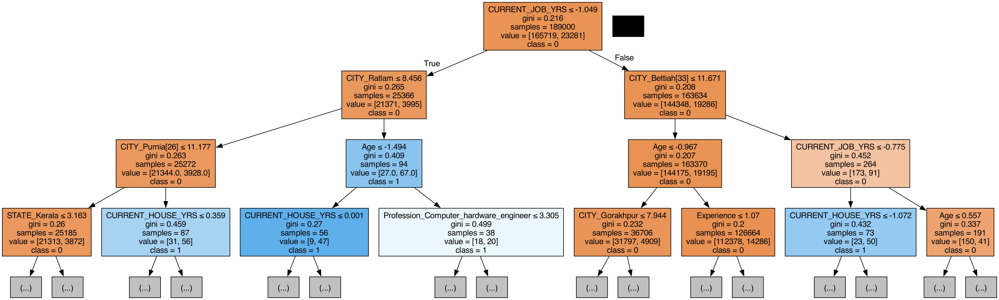

In [27]:
# Set the maximum depth of the decision tree visualization
max_depth = 3

# Visualize the decision tree with a maximum depth
# Create DOT data with limited depth
dot_data = tree.export_graphviz(
    model, out_file=None, feature_names=X.columns, class_names=["0", "1"], filled=True,
    special_characters=True, max_depth=max_depth
)

# Draw graph using 'dot' engine
graph = pydotplus.graph_from_dot_data(dot_data)

# Set DPI to a higher value for better resolution
graph.set('dpi', '300')  

# Export the decision tree visualization as an image
image_path = "decision_tree_depth_{}.png".format(max_depth)
graph.write_png(image_path)

# Display the exported image
Image(image_path)




In [28]:
import graphviz
from ipywidgets import interact

def visualize_decision_tree(max_depth):
    # Visualize the decision tree with a maximum depth
    # Create DOT data with limited depth
    dot_data = tree.export_graphviz(
        model, out_file=None, feature_names=X.columns, class_names=["0", "1"], filled=True,
        special_characters=True, max_depth=max_depth
    )

    # Render the decision tree using Graphviz
    graph = graphviz.Source(dot_data)
    # Display the rendered decision tree
    display(graph)

# Use interact to create an interactive widget
# Users can adjust the max depth parameter to see different parts of the decision tree
interact(visualize_decision_tree, max_depth=(1, 10, 1))


interactive(children=(IntSlider(value=5, description='max_depth', max=10, min=1), Output()), _dom_classes=('wi…

<function __main__.visualize_decision_tree(max_depth)>

In [29]:
from sklearn.tree import DecisionTreeRegressor

# Create a decision tree regressor model
regressor = DecisionTreeRegressor(max_depth=5)  # Adjust max_depth as needed

# Fit the model to your training data
regressor.fit(X_train, y_train)

# Evaluate the model
train_score = regressor.score(X_train, y_train)
test_score = regressor.score(X_test, y_test)

print("Training R^2 score:", train_score)
print("Testing R^2 score:", test_score)



Training R^2 score: 0.013263271631139828
Testing R^2 score: 0.010208447588226477


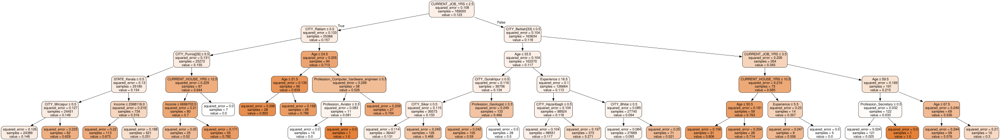

In [30]:
from sklearn.tree import export_graphviz

# Export the decision tree as DOT data
dot_data = export_graphviz(regressor, out_file=None, 
                           feature_names=X.columns,  
                           filled=True, rounded=True,  
                           special_characters=True)  

# Render the decision tree using Graphviz
graph = graphviz.Source(dot_data)  

# Display the decision tree
graph


In [31]:
import ipywidgets as widgets

# Create input widgets for each feature
feature_widgets = []
for feature_name in X.columns:
    feature_widgets.append(widgets.FloatText(description=feature_name))

# Create a button widget for triggering predictions
predict_button = widgets.Button(description="Predict")

# Output widget for displaying predictions
output_widget = widgets.Output()

def predict_values(button_click):
    # Extract input values from widgets
    input_values = [widget.value for widget in feature_widgets]
    input_array = np.array(input_values).reshape(1, -1)
    
    # Predict using the decision tree regressor
    prediction = regressor.predict(input_array)
    
    # Display prediction
    with output_widget:
        output_widget.clear_output()
        print("Predicted Value:", prediction[0])

# Bind the predict_values function to the button click event
predict_button.on_click(predict_values)

# Create a vertical box layout for arranging widgets
input_box = widgets.VBox(feature_widgets + [predict_button, output_widget])

# Display the input widgets
display(input_box)
